# Jupyter Notebook for the Extraction of Various Features Based on the Segmentation Masks of Mouse Retinal Blood Vessels

In [1]:
#Synchronize with Google Drive
from google.colab import drive
drive.mount('/content/drive/', force_remount = True)

Mounted at /content/drive/


In [ ]:
#install the necessary packages
#https://github.com/jni/skan
!pip install skan

# Read the Images and the Segmentation Masks

In [ ]:
#directories containing the images and the segmentation masks
img_dir = r'/content/drive/My Drive/masks/resultsproc_all_masks/images'
mask_dir = r'/content/drive/My Drive/masks/resultsproc_all_masks/masks'

In [ ]:
import tifffile
import numpy as np
import os
from skimage.morphology import convex_hull_image

#read the images and the segmentation masks
images_list = []
imgs_names = []
masks_list = []
names_group = []

images_names_ignore = ['iROCK_ret3_stiched.tif', 'RGDS-stitched-ret1.tif',
                      'VEGF_ret4.tif',
                      'VEGF_ret5.tif', 'VEGF_ret6.tif', 
                      'FLIJ10_TG_stiching_2ndExp_1.tif',
                      'FLIJ11_TG_stiching_2ndExp_1.tif',
                      'PBS_old_ret1.tif',
                      'Hemaxi_ICAM2.tif',
                      'sFLT1_ret2.tif',
                      'sFLT1_ret3.tif']

masks_names_ignore = ['iROCK_ret3_mask.tif.tif', 'RGDS-ret1_mask.tif.tif', 
                      'VEGF_ret4_mask.tif.tif',
                      'VEGF_ret5_mask.tif.tif', 'VEGF_ret6_mask.tif.tif', 
                      'FLIJ10_TG_stiching_2ndExp_1.tif.tif',
                      'FLIJ11_TG_stiching_2ndExp_1.tif.tif',
                      'PBS_old_ret1_mask.tif.tif',
                      'hemaxi_icam_2d_mask.tif.tif',
                      'sFLT1_ret2-03_mask.tif.tif',
                      'sFLT1_ret3_mask.tif.tif']

group_names = ['PBS', 'sFLT1', 
               'VEGF', 'AngII',
               'Captopril', 'RGDS',
               'FLIJ', 'FLIO', 'FLIP']

for img, msk in zip(sorted(os.listdir(img_dir)), sorted(os.listdir(mask_dir))):

    if msk not in masks_names_ignore:
        found = False
        for name_ in group_names:
            if not found and name_ in msk:
                    names_group.append(name_)
                    found = True

    if found:
        print('------------------------')
        print('Image name:{}'.format(img))
        print('Mask name:{}'.format(msk))
        print('------------------------')
        imgs_names.append(img)
        image = os.path.join(img_dir, img)
        mask = os.path.join(mask_dir, msk)
        images_list.append(image)
        masks_list.append(mask)
        found = False
    

------------------------
Image name:Captopril_new_ret1_stiched.tif
Mask name:Captopril_new_ret1_stiched.tif.tif
------------------------
------------------------
Image name:Captopril_new_ret2_stiched.tif
Mask name:Captopril_new_ret2_stiched.tif.tif
------------------------
------------------------
Image name:Captopril_new_ret3_stitched.tif
Mask name:Captopril_new_ret3_stitched.tif.tif
------------------------
------------------------
Image name:FLIJ7_TG_stiching_1.tif
Mask name:FLIJ7_TG_stiching_1.tif.tif
------------------------
------------------------
Image name:FLIJ7_TG_stiching_2ndExp_1.tif
Mask name:FLIJ7_TG_stiching_2ndExp_1.tif.tif
------------------------
------------------------
Image name:FLIJ8_WT_stiching_2ndExp_1.tif
Mask name:FLIJ8_WT_stiching_2ndExp_1.tif.tif
------------------------
------------------------
Image name:FLIJ9_TG_stiching_1.tif
Mask name:FLIJ9_TG_stiching_1.tif.tif
------------------------
------------------------
Image name:FLIJ9_TG_stiching_2ndExp_1.tif


<ipython-input-8-c976c69be646>:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, (ax1, ax2, ax3) = plt.subplots(1,3)


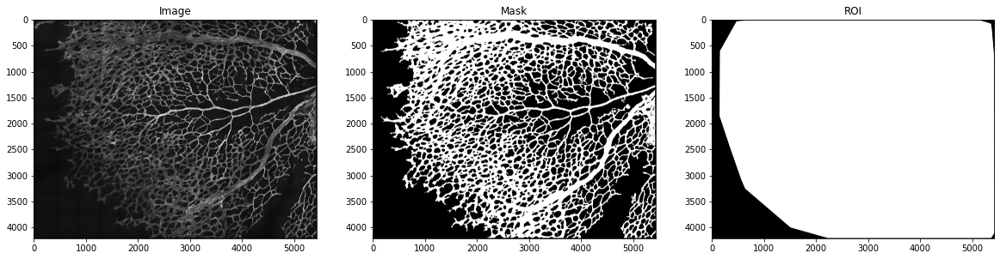

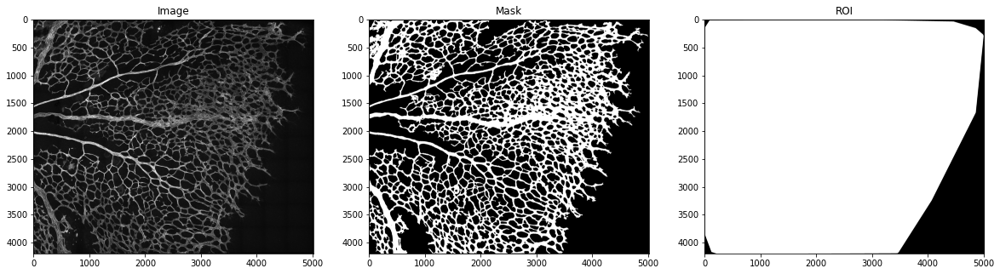

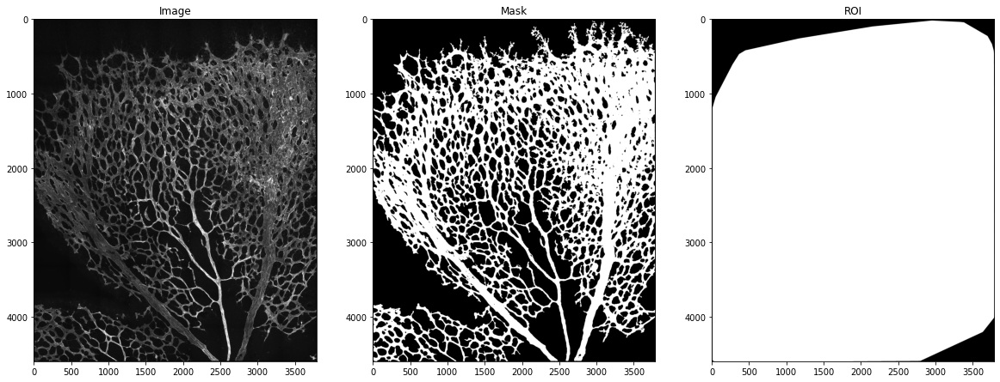

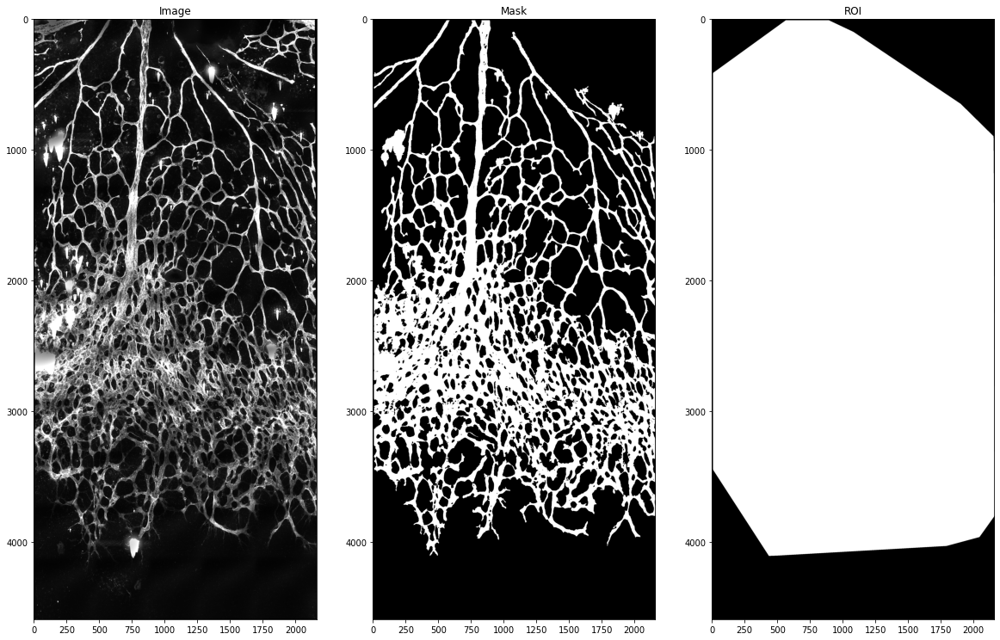

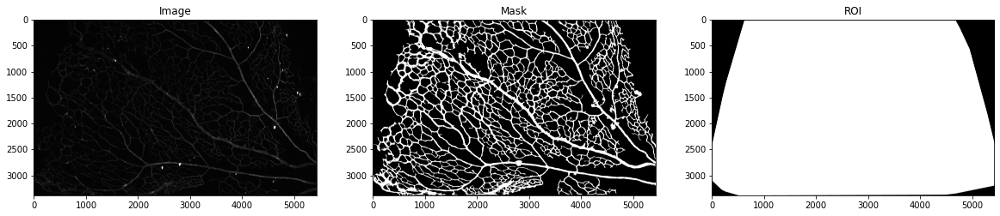

...

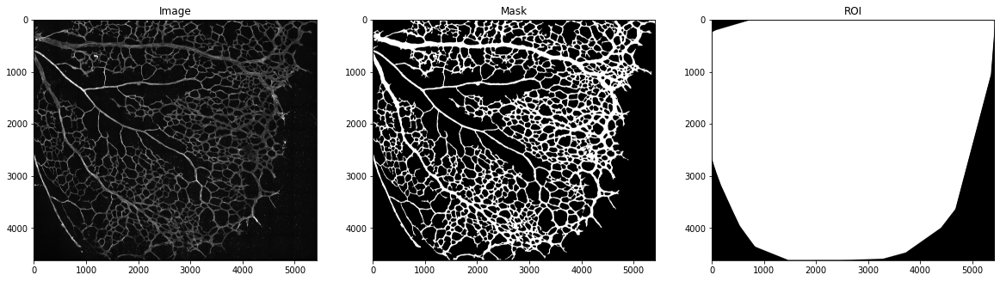

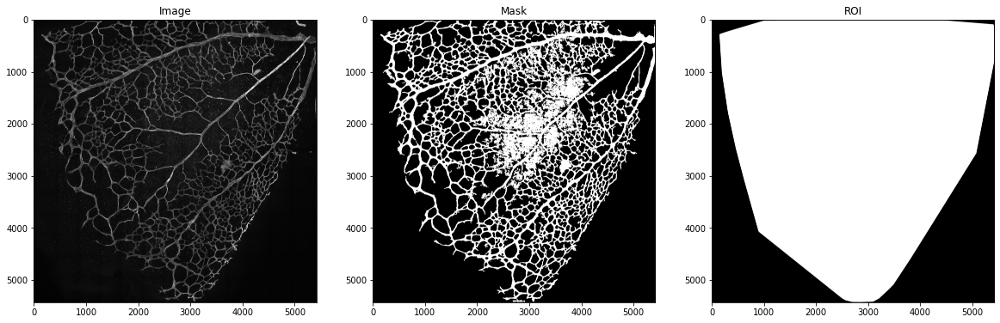

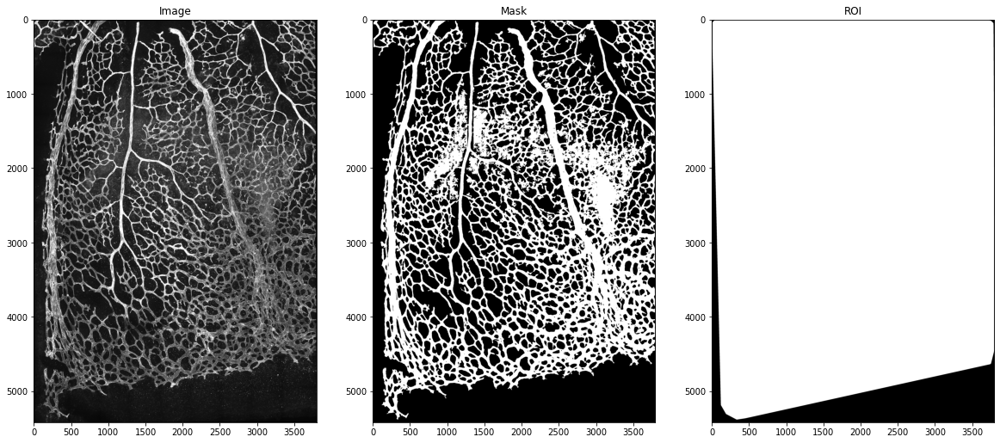

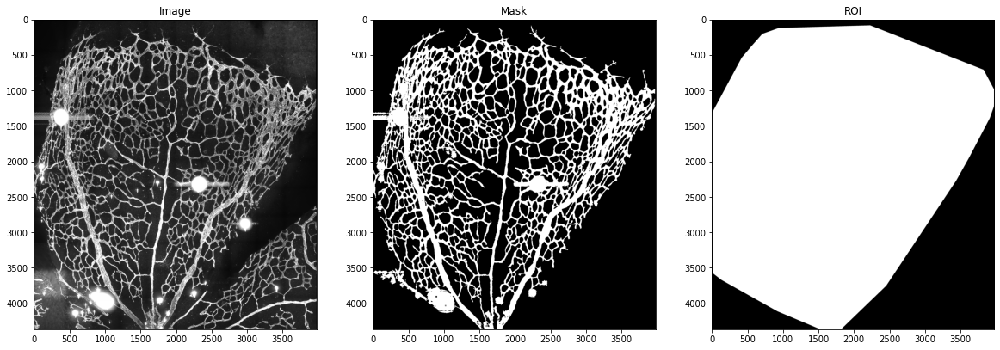

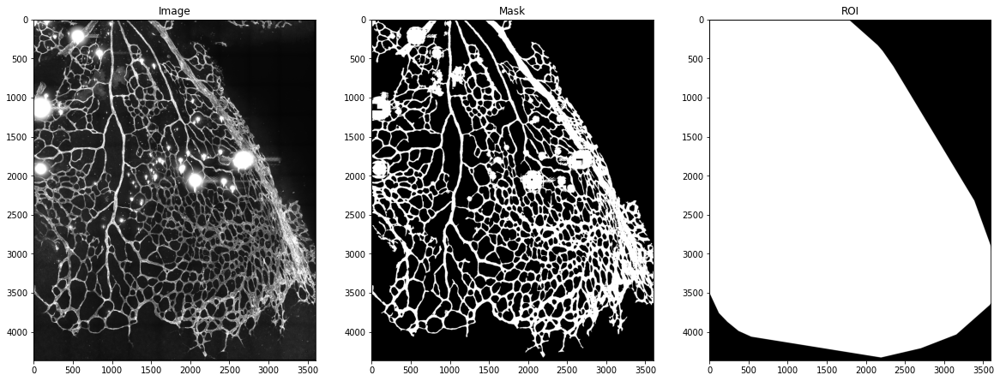

In [ ]:
#Check if the images and masks were correctly loaded
#and if the ROI is correctly defined

index_ = 4

import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (20,20)

for index_ in range(0, len(images_list)):
    f, (ax1, ax2, ax3) = plt.subplots(1,3)
    ax1.imshow(tifffile.imread(images_list[index_]), cmap='gray')
    ax1.set_title('Image')
    ax2.imshow(tifffile.imread(masks_list[index_]), cmap='gray')
    ax2.set_title('Mask')
    #region of interest
    chull = convex_hull_image(tifffile.imread(masks_list[index_]))
    chull = chull*1
    ax3.imshow(chull, cmap='gray')
    ax3.set_title('ROI')

# Create a Pandas Dataframe containing the Vasculature Features

Features considered in this work:
*   Number of Bifurcations
*   Number of End Points
*   Vessel Density
*   Avascular Area
*   Branch Length
*   Vessel Radius







In [ ]:
#Function for the computation of the number of bifurcations and end points
def branching_points(branch_data):
    branch_points=0
    end_points=0
    node_origin = branch_data['node-id-src'].values.tolist()
    node_destination = branch_data['node-id-dst'].values.tolist()
    all_nodes = node_origin + node_destination
    aux_list = np.array(all_nodes)
    bpoints_id = []
    epoints_id = []
    for element in np.unique(aux_list):
        occur = all_nodes.count(element)
        if occur>=3:
            branch_points=branch_points+1
            bpoints_id.append(element)
        elif occur==1:
            end_points=end_points+1
            epoints_id.append(element)
    return branch_points, bpoints_id, end_points, epoints_id

In [ ]:
import pandas as pd
from skimage import morphology
from scipy import ndimage
from skan import draw
from skan import Skeleton, summarize
from scipy.ndimage import distance_transform_edt
import cv2
import matplotlib.pyplot as plt

vessel_features = pd.DataFrame(columns=('Image', 'Group', '# Bifurcations', '# End Points',
                                      'Vessel Density %', 'Avascular Area %', 'Branch Lengths',
                                      'Mean Branch Length', 'Vessel Radius', 'Mean Vessel Radius'))

for i in range(len(images_list)):
    img_name = imgs_names[i]
    print('Image: {}'.format(img_name))
    group_name = names_group[i]
    print('Treatment: {}'.format(group_name))

    #region of interest
    mask = tifffile.imread(masks_list[i])
    chull = convex_hull_image(mask)
    chull = chull*1

    #skeletonize the mask
    mask = ndimage.binary_erosion(mask, structure=np.ones((3,3))).astype(mask.dtype)
    mask = ndimage.binary_dilation(mask, structure=np.ones((3,3))).astype(mask.dtype)
    mask[mask!=0] =1
    skeleton = morphology.skeletonize(mask, method='lee')


    #compute the vascular density and avascular area
    mask[chull==0] = 100 #ignore the area outside the ROI
    total_area = len(chull[chull==1]) #total area of the ROI
    vasc_dens = (len(mask[mask==1]) / (total_area) ) * 100 #vascular density
    avas_area = (len(mask[mask==0]) / (total_area) ) * 100 #avascular area


    #overlap between image and skeleton
    #fig, ax = plt.subplots()
    #draw.overlay_skeleton_2d(tifffile.imread(images_list[i]), skeleton, dilate=1, axes=ax);

    #features extracted based on the skeleton using the skan package
    branch_data = summarize(Skeleton(skeleton))

    bpoints, bids, epoints, eids = branching_points(branch_data)

    #compute the radius
    distance_transform = distance_transform_edt(mask)
    skeleton = skeleton.astype(distance_transform.dtype)
    radius_values = cv2.multiply(skeleton, distance_transform)
    radius_ = np.mean(radius_values[radius_values!=0])

    #add the features to the pandas dataframe
    vessel_features.loc[i] = [img_name, group_name, bpoints/total_area, 
                              epoints/total_area, vasc_dens, avas_area, 
                              branch_data['branch-distance'], branch_data['branch-distance'].mean(),
                              radius_values[radius_values!=0], radius_]

Image: Captopril_new_ret1_stiched.tif
Treatment: Captopril
Image: Captopril_new_ret2_stiched.tif
Treatment: Captopril
Image: Captopril_new_ret3_stitched.tif
Treatment: Captopril
Image: FLIJ7_TG_stiching_1.tif
Treatment: FLIJ
Image: FLIJ7_TG_stiching_2ndExp_1.tif
Treatment: FLIJ
Image: FLIJ8_WT_stiching_2ndExp_1.tif
Treatment: FLIJ
Image: FLIJ9_TG_stiching_1.tif
Treatment: FLIJ
Image: FLIJ9_TG_stiching_2ndExp_1.tif
Treatment: FLIJ
Image: FLIO1a_TG_stiching_2ndExp_2.tif
Treatment: FLIO
Image: FLIO1b_TG_stiching_2ndExp_1.tif
Treatment: FLIO
Image: FLIO4_TG_stiching_2ndExp_1.tif
Treatment: FLIO
Image: FLIO5_TG_stiching_2ndExp_1.tif
Treatment: FLIO
Image: FLIO6_TG_stiching_1.tif
Treatment: FLIO
Image: FLIO6_TG_stiching_2.tif
Treatment: FLIO
Image: FLIO6_TG_stiching_3.tif
Treatment: FLIO
Image: FLIO8_TG_stiching_1.tif
Treatment: FLIO
Image: FLIP1_TG_stiching_1.tif
Treatment: FLIP
Image: FLIP1_TG_stiching_1Exp_1.tif
Treatment: FLIP
Image: FLIP1_TG_stiching_1Exp_2.tif
Treatment: FLIP
Image: FL

In [ ]:
vessel_features

,Image,Group,# Bifurcations,# End Points,Vessel Density %,Avascular Area %,Branch Lengths,Mean Branch Length,Vessel Radius,Mean Vessel Radius
0,Captopril_new_ret1_stiched.tif,Captopril,0.000198,0.000070,45.922607,54.077393,0 3.000000 1 43.112698 2 23...,51.895826,"[1.0, 2.0, 2.0, 1.0, 1.0, 2.0, 2.2360679774997...",18.449192
1,Captopril_new_ret2_stiched.tif,Captopril,0.000165,0.000065,38.315967,61.684033,0 53.313708 1 56.455844 2 28...,55.629611,"[2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, ...",15.952134
2,Captopril_new_ret3_stitched.tif,Captopril,0.000224,0.000094,48.416110,51.583890,0 6.242641 1 7.414214 2 8...,46.588082,"[2.0, 2.23606797749979, 2.0, 1.414213562373095...",20.068351
3,FLIJ7_TG_stiching_1.tif,FLIJ,0.000323,0.000099,37.579716,62.420284,0 32.727922 1 389.984848 2 ...,38.276061,"[7.0, 8.0, 8.94427190999916, 9.219544457292887...",12.576244
4,FLIJ7_TG_stiching_2ndExp_1.tif,FLIJ,0.000178,0.000070,25.254038,74.745962,0 14.485281 1 121.095454 2 ...,49.216167,"[2.23606797749979, 2.0, 2.0, 1.0, 1.0, 2.0, 2....",9.892645
5,FLIJ8_WT_stiching_2ndExp_1.tif,FLIJ,0.000195,0.000066,26.684986,73.315014,0 31.556349 1 30.384776 2 ...,48.151079,"[9.0, 10.0, 10.198039027185569, 10.44030650891...",9.895860
6,FLIJ9_TG_stiching_1.tif,FLIJ,0.000109,0.000039,22.587228,77.412772,0 30.041631 1 187.426407 2 ...,67.985929,"[2.23606797749979, 2.0, 1.0, 2.23606797749979,...",10.431200
7,FLIJ9_TG_stiching_2ndExp_1.tif,FLIJ,0.000147,0.000049,24.765228,75.234772,0 134.982756 1 89.882251 2 ...,55.076852,"[2.23606797749979, 2.0, 1.0, 3.605551275463989...",11.089243
8,FLIO1a_TG_stiching_2ndExp_2.tif,FLIO,0.000094,0.000036,24.341009,75.658991,0 107.041631 1 185.012193 2 ...,71.955702,"[2.23606797749979, 2.0, 2.0, 2.0, 2.0, 1.0, 2....",12.486074
9,FLIO1b_TG_stiching_2ndExp_1.tif,FLIO,0.000077,0.000033,23.150431,76.849569,0 14.899495 1 6.414214 2 ...,73.793024,"[2.0, 2.0, 2.0, 2.0, 2.23606797749979, 1.0, 2....",13.673443


In [ ]:
vessel_features.to_csv('/content/drive/My Drive/masks/resultsproc_all_masks/features_all.csv')

In [ ]:
vessel_features.to_csv('/content/drive/My Drive/masks/resultsproc_all_masks/features.csv', sep=';')

# BoxPlots 

In [2]:
import pandas as pd
vessel_features = pd.read_csv('/content/drive/My Drive/masks/resultsproc_all_masks/features_all.csv')

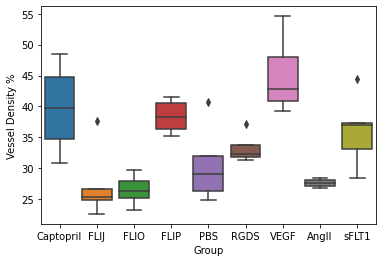

In [ ]:
#df.boxplot(by='Group', column='Vessel Density')
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure()
bplot = sns.boxplot(y='Vessel Density %', x='Group', data=vessel_features)

In [ ]:
vessel_features.drop([45], inplace=True)

In [ ]:
vessel_features

,Unnamed: 0,Image,Group,# Bifurcations,# End Points,Vessel Density %,Avascular Area %,Branch Lengths,Mean Branch Length,Vessel Radius,Mean Vessel Radius
0,0,Captopril_new_ret1_stiched.tif,Captopril,0.000198,0.000070,45.922607,54.077393,0 3.000000\n1 43.112698\n2 ...,51.895826,[1. 2. 2. ... 2.828427...,18.449192
1,1,Captopril_new_ret2_stiched.tif,Captopril,0.000165,0.000065,38.315967,61.684033,0 53.313708\n1 56.455844\n2 ...,55.629611,[2. 2. 2. ... 2. 2. 1.],15.952134
2,2,Captopril_new_ret3_stitched.tif,Captopril,0.000224,0.000094,48.416110,51.583890,0 6.242641\n1 7.414214\n2 ...,46.588082,[2. 2.23606798 2. ... 3.605551...,20.068351
3,3,FLIJ7_TG_stiching_1.tif,FLIJ,0.000323,0.000099,37.579716,62.420284,0 32.727922\n1 389.984848\n2 ...,38.276061,[7. 8. 8.94427191 ... 3.605551...,12.576244
4,4,FLIJ7_TG_stiching_2ndExp_1.tif,FLIJ,0.000178,0.000070,25.254038,74.745962,0 14.485281\n1 121.095454\n2 ...,49.216167,[2.23606798 2. 2. ... 2. ...,9.892645
5,5,FLIJ8_WT_stiching_2ndExp_1.tif,FLIJ,0.000195,0.000066,26.684986,73.315014,0 31.556349\n1 30.384776\n2 ...,48.151079,[ 9. 10. 10.19803903 ... 2. ...,9.895860
6,6,FLIJ9_TG_stiching_1.tif,FLIJ,0.000109,0.000039,22.587228,77.412772,0 30.041631\n1 187.426407\n2 ...,67.985929,[2.23606798 2. 1. ... 4.472135...,10.431200
7,7,FLIJ9_TG_stiching_2ndExp_1.tif,FLIJ,0.000147,0.000049,24.765228,75.234772,0 134.982756\n1 89.882251\n2 ...,55.076852,[2.23606798 2. 1. ... 2.828427...,11.089243
8,8,FLIO1a_TG_stiching_2ndExp_2.tif,FLIO,0.000094,0.000036,24.341009,75.658991,0 107.041631\n1 185.012193\n2 ...,71.955702,[ 2.23606798 2. 2. ... 12.16...,12.486074
9,9,FLIO1b_TG_stiching_2ndExp_1.tif,FLIO,0.000077,0.000033,23.150431,76.849569,0 14.899495\n1 6.414214\n2 ...,73.793024,[2. 2. 2. ... 4.123105...,13.673443


## PBS VEGF sFLT1

In [ ]:
#select images belonging to specific treatments
select_groups = vessel_features.loc[(vessel_features['Group'] == 'PBS') | (vessel_features['Group'] == 'VEGF') | (vessel_features['Group'] == 'sFLT1')]

In [ ]:
select_groups

,Unnamed: 0,Image,Group,# Bifurcations,# End Points,Vessel Density %,Avascular Area %,Branch Lengths,Mean Branch Length,Vessel Radius,Mean Vessel Radius
23,23,PBS_new_ret1.tif,PBS,0.000103,0.000040,26.370447,73.629553,0 71.142136\n1 34.041631\n2 ...,69.732754,[5.38516481 5.83095189 6.32455532 ... 3. ...,12.633796
24,24,PBS_new_ret1b.tif,PBS,0.000142,0.000062,31.951991,68.048009,0 139.325902\n1 123.982756\n2 ...,56.419372,[2.23606798 2. 1. ... 1. ...,14.125438
25,25,PBS_old_ret1.tif,PBS,0.000309,0.000166,40.638228,59.361772,0 72.112698\n1 70.698485\n2 ...,34.902344,[2.23606798 2. 2. ... 6.403124...,14.798438
26,26,PBS_ret1-02-stiched.tif,PBS,0.000130,0.000045,24.887831,75.112169,0 529.244733\n1 201.149278\n2 ...,58.727499,[ 3.60555128 3.16227766 2.82842712 ... 22. ...,11.606714
27,27,PBS_ret4.tif,PBS,0.000161,0.000048,28.994975,71.005025,0 574.678282\n1 144.526912\n2 ...,58.878923,[3.60555128 2.82842712 2.23606798 ... 6. ...,10.881693
34,34,VEGF_ret1.tif,VEGF,0.000226,0.000054,41.919204,58.080796,0 28.627417\n1 20.556349\n2 ...,47.509381,[2.23606798 2. 1. ... 7. ...,16.627002
35,35,VEGF_ret1b.tif,VEGF,0.000313,0.000055,47.338700,52.661300,0 14.071068\n1 78.627417\n2 ...,37.969935,[2.23606798 2. 1. ... 9. ...,18.359697
36,36,VEGF_ret3.tif,VEGF,0.000351,0.000067,54.596767,45.403233,0 49.012193\n1 17.556349\n2 ...,40.361496,[2.23606798 2. 2. ... 6.403124...,18.170792
37,37,VEGF_ret4.tif,VEGF,0.000281,0.000070,39.972935,60.027065,0 40.384776\n1 141.497475\n2 ...,39.399360,[2.23606798 2. 1. ... 4.242640...,15.600041
38,38,VEGF_ret5.tif,VEGF,0.000203,0.000068,42.806086,57.193914,0 60.698485\n1 26.970563\n2 ...,46.723660,[2. 2.23606798 2. ... 2. ...,18.960126


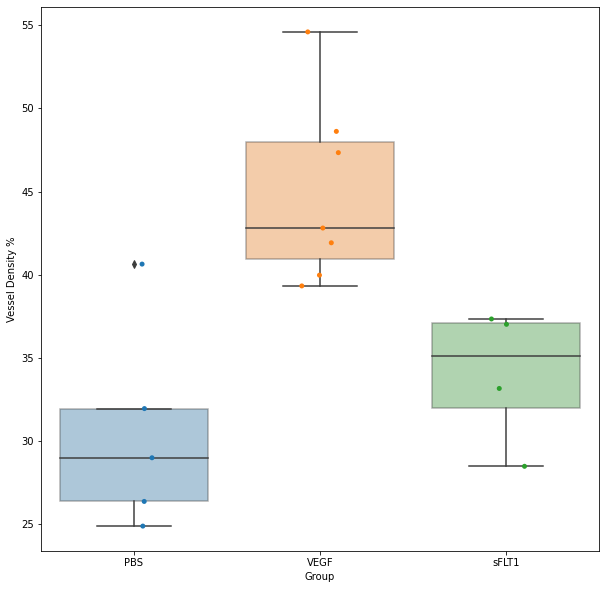

In [ ]:
import seaborn as sns
from matplotlib.legend_handler import HandlerTuple
plt.rcParams["figure.figsize"] = (10,10)
ax = sns.boxplot(data=select_groups, x="Group", y="Vessel Density %",
                 boxprops={'alpha': 0.4})
sns.stripplot(data=select_groups, x="Group", y="Vessel Density %",
              dodge=True, ax=ax)
handles, labels = ax.get_legend_handles_labels()

## PBS ANGII Captopril

In [3]:
#select images belonging to specific treatments
select_groups = vessel_features.loc[(vessel_features['Group'] == 'PBS') | (vessel_features['Group'] == 'AngII') | (vessel_features['Group'] == 'Captopril')]

In [6]:
select_groups

,Unnamed: 0,Image,Group,# Bifurcations,# End Points,Vessel Density %,Avascular Area %,Branch Lengths,Mean Branch Length,Vessel Radius,Mean Vessel Radius
0,0,Captopril_new_ret1_stiched.tif,Captopril,0.000198,0.000070,45.922607,54.077393,0 3.000000\n1 43.112698\n2 ...,51.895826,[1. 2. 2. ... 2.828427...,18.449192
1,1,Captopril_new_ret2_stiched.tif,Captopril,0.000165,0.000065,38.315967,61.684033,0 53.313708\n1 56.455844\n2 ...,55.629611,[2. 2. 2. ... 2. 2. 1.],15.952134
2,2,Captopril_new_ret3_stitched.tif,Captopril,0.000224,0.000094,48.416110,51.583890,0 6.242641\n1 7.414214\n2 ...,46.588082,[2. 2.23606798 2. ... 3.605551...,20.068351
22,22,Maria_Captopril_ret6_stiched.tif,Captopril,0.000152,0.000057,33.582802,66.417198,0 154.284271\n1 4.000000\n2 ...,57.378494,[2.23606798 2. 2. ... 2.236067...,14.140062
23,23,PBS_new_ret1.tif,PBS,0.000103,0.000040,26.370447,73.629553,0 71.142136\n1 34.041631\n2 ...,69.732754,[5.38516481 5.83095189 6.32455532 ... 3. ...,12.633796
24,24,PBS_new_ret1b.tif,PBS,0.000142,0.000062,31.951991,68.048009,0 139.325902\n1 123.982756\n2 ...,56.419372,[2.23606798 2. 1. ... 1. ...,14.125438
25,25,PBS_old_ret1.tif,PBS,0.000309,0.000166,40.638228,59.361772,0 72.112698\n1 70.698485\n2 ...,34.902344,[2.23606798 2. 2. ... 6.403124...,14.798438
26,26,PBS_ret1-02-stiched.tif,PBS,0.000130,0.000045,24.887831,75.112169,0 529.244733\n1 201.149278\n2 ...,58.727499,[ 3.60555128 3.16227766 2.82842712 ... 22. ...,11.606714
27,27,PBS_ret4.tif,PBS,0.000161,0.000048,28.994975,71.005025,0 574.678282\n1 144.526912\n2 ...,58.878923,[3.60555128 2.82842712 2.23606798 ... 6. ...,10.881693
32,32,Ret4_Maria_Captopril_1-stiched.tif,Captopril,0.000167,0.000052,30.761017,69.238983,0 75.455844\n1 28.142136\n2 ...,53.874884,[ 1. 2. 2.23606798 ... 9.05...,12.711096


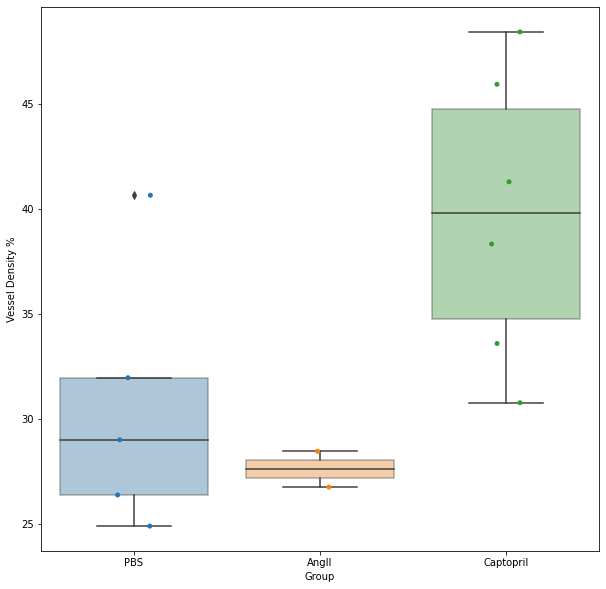

In [8]:
import seaborn as sns
from matplotlib.legend_handler import HandlerTuple
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (10,10)
ax = sns.boxplot(data=select_groups, x="Group", y="Vessel Density %", 
                 order= ['PBS', 'AngII', 'Captopril'],
                 boxprops={'alpha': 0.4})
sns.stripplot(data=select_groups, x="Group", y="Vessel Density %",
              order= ['PBS', 'AngII', 'Captopril'],
              dodge=True, ax=ax)
handles, labels = ax.get_legend_handles_labels()

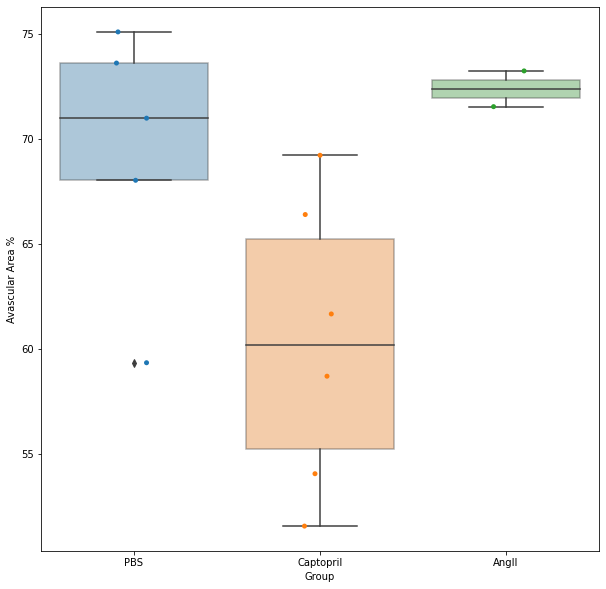

In [9]:
import seaborn as sns
from matplotlib.legend_handler import HandlerTuple
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (10,10)
ax = sns.boxplot(data=select_groups, x="Group", y="Avascular Area %", 
                 order= ['PBS', 'Captopril', 'AngII'],
                 boxprops={'alpha': 0.4})
sns.stripplot(data=select_groups, x="Group", y="Avascular Area %",
              order= ['PBS', 'Captopril', 'AngII'],
              dodge=True, ax=ax)
handles, labels = ax.get_legend_handles_labels()